# Challenge


# 1. Knowledge domain
# 2. Exploratory analysis
# 3. Machine learning model
## 3.1. First approach
## 3.2. Second approach
# 4. Result of the competition
# References

------------------

En este notebook:

## 3.2. Second approach
### Knn
### Decision Tree
### Gaussian NB
### Random Forest
# 4. Result of the competition
# References

--------------

## 3.2. Second approach

### Cargo Valores

In [117]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from pandas import Series, DataFrame

import warnings
warnings.filterwarnings('ignore')

# data = pd.read_csv('data/train.csv', sep=",", encoding = "ISO-8859-1")
# df = data.copy()

data_test_nolabel = pd.read_csv('data/test_nolabel.csv', sep=",", encoding = "ISO-8859-1")
df_test_nolabel = data_test_nolabel.copy()

In [118]:
data_test_nolabel = pd.read_csv('data/test_nolabel.csv', sep=",", encoding = "ISO-8859-1")
df_test_nolabel = data_test_nolabel.copy()

### Cambios en Features

### DisbursementDate

In [119]:
# drop ChgOffDate column
#df.drop(['ChgOffDate'], axis=1, inplace=True)
df.drop(['State'], axis=1, inplace=True)
df.drop(['BalanceGross'], axis=1, inplace=True)
df.drop(['id'], axis=1, inplace=True)

# drop ChgOffDate column
#df_test_nolabel.drop(['ChgOffDate'], axis=1, inplace=True)
df_test_nolabel.drop(['State'], axis=1, inplace=True)
df_test_nolabel.drop(['BalanceGross'], axis=1, inplace=True)
#df_test_nolabel.drop(['id'], axis=1, inplace=True)

KeyError: "['State'] not found in axis"

In [120]:
#Change the format into datetime
df['DisbursementDate'] = pd.to_datetime(data['DisbursementDate'])

#Change the format into datetime
df_test_nolabel['DisbursementDate'] = pd.to_datetime(data['DisbursementDate'])

In [121]:
df['DisbursementDay'] = df['DisbursementDate'].apply(lambda x: x.day)

df_test_nolabel['DisbursementDay'] = df_test_nolabel['DisbursementDate'].apply(lambda x: x.day)

In [122]:
df['DisbursementMonth'] = df['DisbursementDate'].apply(lambda x: x.month)
df_test_nolabel['DisbursementMonth'] = df_test_nolabel['DisbursementDate'].apply(lambda x: x.month)

In [123]:
df['DisbursementYear'] = df['DisbursementDate'].apply(lambda x: x.year)
df_test_nolabel['DisbursementYear'] = df_test_nolabel['DisbursementDate'].apply(lambda x: x.year)

In [124]:
# We can now delete the 'DisbursementDate' column.
df.drop(['DisbursementDate'], axis=1, inplace=True)
# We can now delete the 'DisbursementDate' column.
df_test_nolabel.drop(['DisbursementDate'], axis=1, inplace=True)

### ApprovalDate

In [125]:
#Change the format into datetime
df['ApprovalDate'] = pd.to_datetime(data['ApprovalDate'])
#Change the format into datetime
df_test_nolabel['ApprovalDate'] = pd.to_datetime(data['ApprovalDate'])

In [126]:
df['ApprovalDay'] = df['ApprovalDate'].apply(lambda x: x.day)
df['ApprovalMonth'] = df['ApprovalDate'].apply(lambda x: x.month)
df['ApprovalYear'] = df['ApprovalDate'].apply(lambda x: x.year)

df_test_nolabel['ApprovalDay'] = df_test_nolabel['ApprovalDate'].apply(lambda x: x.day)
df_test_nolabel['ApprovalMonth'] = df_test_nolabel['ApprovalDate'].apply(lambda x: x.month)
df_test_nolabel['ApprovalYear'] = df_test_nolabel['ApprovalDate'].apply(lambda x: x.year)

In [127]:
# We can now delete the 'ApprovalDate' column.
df.drop(['ApprovalDate'], axis=1, inplace=True)
# We can now delete the 'ApprovalDate' column.
df_test_nolabel.drop(['ApprovalDate'], axis=1, inplace=True)

### DisbursementGross

In [128]:
def clean_currency(x):
   
    if isinstance(x, str):
        return(x.replace('$', '').replace(',', ''))
    return(x)

In [129]:
df['DisbursementGross'] = df['DisbursementGross'].apply(clean_currency).astype('float')
df_test_nolabel['DisbursementGross'] = df_test_nolabel['DisbursementGross'].apply(clean_currency).astype('float')

### ChgOffDate

In [130]:
df['ChgOffDate'] = df['ChgOffDate'].fillna(1)

for i in range(len(df)):
    if df['ChgOffDate'][i] != 1 :
        df['ChgOffDate'][i] = 0   

df['ChgOffDate'] = df['ChgOffDate'].astype(int)

df_test_nolabel['ChgOffDate'] = df_test_nolabel['ChgOffDate'].fillna(1)

for i in range(len(df_test_nolabel)):
    if df_test_nolabel['ChgOffDate'][i] != 1 :
        df_test_nolabel['ChgOffDate'][i] = 0   
        
df_test_nolabel['ChgOffDate'] = df_test_nolabel['ChgOffDate'].astype(int)

In [131]:
df.head(10)

,LoanNr_ChkDgt,Name,City,Bank,BankState,ApprovalFY,NoEmp,NewExist,CreateJob,RetainedJob,...,LowDoc,ChgOffDate,DisbursementGross,Accept,DisbursementDay,DisbursementMonth,DisbursementYear,ApprovalDay,ApprovalMonth,ApprovalYear
0,6340864010,0,ODESSA,WELLS FARGO BANK NATL ASSOC,SD,2003,10,1.0,2,10,...,N,1,150000.0,1,30.0,6.0,2003.0,22,5,2003
1,1670916004,1,KELLER,WELLS FARGO BANK NATL ASSOC,CA,2006,1,1.0,0,1,...,N,1,250000.0,1,31.0,7.0,2006.0,7,4,2006
2,7568313003,2,EL PASO,BANK OF AMERICA NATL ASSOC,TX,1994,5,2.0,0,0,...,Y,1,53000.0,1,31.0,10.0,1994.0,12,9,1994
3,4585814005,3,SAN ANTONIO,COMPASS BANK,AL,2001,1,2.0,3,1,...,N,1,170000.0,1,31.0,8.0,2001.0,18,6,2001
4,2003866003,4,ODESSA,SOUTHWEST BANK,TX,2006,5,1.0,0,5,...,N,1,121000.0,1,31.0,5.0,2006.0,12,5,2006
5,6816864006,5,FORT WORTH,"BUSINESS LOAN CENTER, LLC",SC,2004,24,1.0,20,4,...,N,1,1111000.0,1,31.0,10.0,2003.0,20,10,2003
6,7479744008,6,ARLINGTON,COMMUNITY BANK,TX,2004,8,1.0,0,8,...,N,1,150000.0,1,30.0,6.0,2004.0,28,5,2004
7,3075105006,7,CEDAR HILL,JPMORGAN CHASE BANK NATL ASSOC,IL,2008,1,1.0,1,1,...,N,0,122026.0,0,31.0,5.0,2008.0,2,5,2008
8,7362314004,8,MIDLAND,PROSPERITY BANK,TX,2004,3,2.0,0,0,...,Y,0,85000.0,0,30.0,4.0,2004.0,16,4,2004
9,3204516004,9,AUSTIN,COMPASS BANK,AL,2008,1,1.0,0,1,...,N,0,13844.0,0,1.0,6.0,2010.0,25,3,2008


## Name

In [132]:
name = []

lista_1 = dict()
for i in range (0, 49320): 
    name.append(df['Name'][i])
    
for j in range (0, 49320):
        
    if df['Name'][j] not in lista_1: 
        c = name[j]
        df['Name'][j] = j
        lista_1[c] = j
        print(c)
        print(df['Name'][j])
        print(lista_1)
        
    else :
        df['Name'][j] = lista_1[df['Name'][j]]

0
0
{0: 0}
1
1
{0: 0, 1: 1}
2
2
{0: 0, 1: 1, 2: 2}
3
3
{0: 0, 1: 1, 2: 2, 3: 3}
4
4
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4}
5
5
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5}
6
6
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6}
7
7
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7}
8
8
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8}
9
9
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9}
10
10
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10}
11
11
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11}
12
12
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12}
13
13
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13}
14
14
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14}
15
15
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15}
16
16
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7

191
191
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15, 16: 16, 17: 17, 18: 18, 19: 19, 20: 20, 21: 21, 22: 22, 23: 23, 24: 24, 25: 25, 26: 26, 27: 27, 28: 28, 29: 29, 30: 30, 31: 31, 32: 32, 33: 33, 34: 34, 35: 35, 36: 36, 37: 37, 38: 38, 39: 39, 40: 40, 41: 41, 42: 42, 43: 43, 44: 44, 45: 45, 46: 46, 47: 47, 48: 48, 49: 49, 50: 50, 51: 51, 52: 52, 53: 53, 54: 54, 55: 55, 56: 56, 57: 57, 58: 58, 59: 59, 60: 60, 61: 61, 62: 62, 63: 63, 64: 64, 65: 65, 66: 66, 67: 67, 68: 68, 69: 69, 70: 70, 71: 71, 72: 72, 73: 73, 74: 74, 75: 75, 76: 76, 77: 77, 78: 78, 79: 79, 80: 80, 81: 81, 82: 82, 83: 83, 84: 84, 85: 85, 86: 86, 87: 87, 88: 88, 89: 89, 90: 90, 91: 91, 92: 92, 93: 93, 94: 94, 95: 95, 96: 96, 97: 97, 98: 98, 99: 99, 100: 100, 101: 101, 102: 102, 103: 103, 104: 104, 105: 105, 106: 106, 107: 107, 108: 108, 109: 109, 110: 110, 111: 111, 112: 112, 113: 113, 114: 114, 115: 115, 116: 116, 117: 117, 118: 118, 119: 119, 120: 120, 1

316
316
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15, 16: 16, 17: 17, 18: 18, 19: 19, 20: 20, 21: 21, 22: 22, 23: 23, 24: 24, 25: 25, 26: 26, 27: 27, 28: 28, 29: 29, 30: 30, 31: 31, 32: 32, 33: 33, 34: 34, 35: 35, 36: 36, 37: 37, 38: 38, 39: 39, 40: 40, 41: 41, 42: 42, 43: 43, 44: 44, 45: 45, 46: 46, 47: 47, 48: 48, 49: 49, 50: 50, 51: 51, 52: 52, 53: 53, 54: 54, 55: 55, 56: 56, 57: 57, 58: 58, 59: 59, 60: 60, 61: 61, 62: 62, 63: 63, 64: 64, 65: 65, 66: 66, 67: 67, 68: 68, 69: 69, 70: 70, 71: 71, 72: 72, 73: 73, 74: 74, 75: 75, 76: 76, 77: 77, 78: 78, 79: 79, 80: 80, 81: 81, 82: 82, 83: 83, 84: 84, 85: 85, 86: 86, 87: 87, 88: 88, 89: 89, 90: 90, 91: 91, 92: 92, 93: 93, 94: 94, 95: 95, 96: 96, 97: 97, 98: 98, 99: 99, 100: 100, 101: 101, 102: 102, 103: 103, 104: 104, 105: 105, 106: 106, 107: 107, 108: 108, 109: 109, 110: 110, 111: 111, 112: 112, 113: 113, 114: 114, 115: 115, 116: 116, 117: 117, 118: 118, 119: 119, 120: 120, 1

432
432
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15, 16: 16, 17: 17, 18: 18, 19: 19, 20: 20, 21: 21, 22: 22, 23: 23, 24: 24, 25: 25, 26: 26, 27: 27, 28: 28, 29: 29, 30: 30, 31: 31, 32: 32, 33: 33, 34: 34, 35: 35, 36: 36, 37: 37, 38: 38, 39: 39, 40: 40, 41: 41, 42: 42, 43: 43, 44: 44, 45: 45, 46: 46, 47: 47, 48: 48, 49: 49, 50: 50, 51: 51, 52: 52, 53: 53, 54: 54, 55: 55, 56: 56, 57: 57, 58: 58, 59: 59, 60: 60, 61: 61, 62: 62, 63: 63, 64: 64, 65: 65, 66: 66, 67: 67, 68: 68, 69: 69, 70: 70, 71: 71, 72: 72, 73: 73, 74: 74, 75: 75, 76: 76, 77: 77, 78: 78, 79: 79, 80: 80, 81: 81, 82: 82, 83: 83, 84: 84, 85: 85, 86: 86, 87: 87, 88: 88, 89: 89, 90: 90, 91: 91, 92: 92, 93: 93, 94: 94, 95: 95, 96: 96, 97: 97, 98: 98, 99: 99, 100: 100, 101: 101, 102: 102, 103: 103, 104: 104, 105: 105, 106: 106, 107: 107, 108: 108, 109: 109, 110: 110, 111: 111, 112: 112, 113: 113, 114: 114, 115: 115, 116: 116, 117: 117, 118: 118, 119: 119, 120: 120, 1

533
533
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15, 16: 16, 17: 17, 18: 18, 19: 19, 20: 20, 21: 21, 22: 22, 23: 23, 24: 24, 25: 25, 26: 26, 27: 27, 28: 28, 29: 29, 30: 30, 31: 31, 32: 32, 33: 33, 34: 34, 35: 35, 36: 36, 37: 37, 38: 38, 39: 39, 40: 40, 41: 41, 42: 42, 43: 43, 44: 44, 45: 45, 46: 46, 47: 47, 48: 48, 49: 49, 50: 50, 51: 51, 52: 52, 53: 53, 54: 54, 55: 55, 56: 56, 57: 57, 58: 58, 59: 59, 60: 60, 61: 61, 62: 62, 63: 63, 64: 64, 65: 65, 66: 66, 67: 67, 68: 68, 69: 69, 70: 70, 71: 71, 72: 72, 73: 73, 74: 74, 75: 75, 76: 76, 77: 77, 78: 78, 79: 79, 80: 80, 81: 81, 82: 82, 83: 83, 84: 84, 85: 85, 86: 86, 87: 87, 88: 88, 89: 89, 90: 90, 91: 91, 92: 92, 93: 93, 94: 94, 95: 95, 96: 96, 97: 97, 98: 98, 99: 99, 100: 100, 101: 101, 102: 102, 103: 103, 104: 104, 105: 105, 106: 106, 107: 107, 108: 108, 109: 109, 110: 110, 111: 111, 112: 112, 113: 113, 114: 114, 115: 115, 116: 116, 117: 117, 118: 118, 119: 119, 120: 120, 1

642
642
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15, 16: 16, 17: 17, 18: 18, 19: 19, 20: 20, 21: 21, 22: 22, 23: 23, 24: 24, 25: 25, 26: 26, 27: 27, 28: 28, 29: 29, 30: 30, 31: 31, 32: 32, 33: 33, 34: 34, 35: 35, 36: 36, 37: 37, 38: 38, 39: 39, 40: 40, 41: 41, 42: 42, 43: 43, 44: 44, 45: 45, 46: 46, 47: 47, 48: 48, 49: 49, 50: 50, 51: 51, 52: 52, 53: 53, 54: 54, 55: 55, 56: 56, 57: 57, 58: 58, 59: 59, 60: 60, 61: 61, 62: 62, 63: 63, 64: 64, 65: 65, 66: 66, 67: 67, 68: 68, 69: 69, 70: 70, 71: 71, 72: 72, 73: 73, 74: 74, 75: 75, 76: 76, 77: 77, 78: 78, 79: 79, 80: 80, 81: 81, 82: 82, 83: 83, 84: 84, 85: 85, 86: 86, 87: 87, 88: 88, 89: 89, 90: 90, 91: 91, 92: 92, 93: 93, 94: 94, 95: 95, 96: 96, 97: 97, 98: 98, 99: 99, 100: 100, 101: 101, 102: 102, 103: 103, 104: 104, 105: 105, 106: 106, 107: 107, 108: 108, 109: 109, 110: 110, 111: 111, 112: 112, 113: 113, 114: 114, 115: 115, 116: 116, 117: 117, 118: 118, 119: 119, 120: 120, 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




2304
{0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15, 16: 16, 17: 17, 18: 18, 19: 19, 20: 20, 21: 21, 22: 22, 23: 23, 24: 24, 25: 25, 26: 26, 27: 27, 28: 28, 29: 29, 30: 30, 31: 31, 32: 32, 33: 33, 34: 34, 35: 35, 36: 36, 37: 37, 38: 38, 39: 39, 40: 40, 41: 41, 42: 42, 43: 43, 44: 44, 45: 45, 46: 46, 47: 47, 48: 48, 49: 49, 50: 50, 51: 51, 52: 52, 53: 53, 54: 54, 55: 55, 56: 56, 57: 57, 58: 58, 59: 59, 60: 60, 61: 61, 62: 62, 63: 63, 64: 64, 65: 65, 66: 66, 67: 67, 68: 68, 69: 69, 70: 70, 71: 71, 72: 72, 73: 73, 74: 74, 75: 75, 76: 76, 77: 77, 78: 78, 79: 79, 80: 80, 81: 81, 82: 82, 83: 83, 84: 84, 85: 85, 86: 86, 87: 87, 88: 88, 89: 89, 90: 90, 91: 91, 92: 92, 93: 93, 94: 94, 95: 95, 96: 96, 97: 97, 98: 98, 99: 99, 100: 100, 101: 101, 102: 102, 103: 103, 104: 104, 105: 105, 106: 106, 107: 107, 108: 108, 109: 109, 110: 110, 111: 111, 112: 112, 113: 113, 114: 114, 115: 115, 116: 116, 117: 117, 118: 118, 119: 119, 120: 120, 121

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [133]:
name = []

lista_1 = dict()
for i in range (0, 7994): 
    name.append(df_test_nolabel['Name'][i])
    
for j in range (0, 7994):
        
    if df_test_nolabel['Name'][j] not in lista_1: 
        c = name[j]
        df_test_nolabel['Name'][j] = j
        lista_1[c] = j
        print(c)
        print(df_test_nolabel['Name'][j])
        print(lista_1)
        
    else :
        df_test_nolabel['Name'][j] = lista_1[df_test_nolabel['Name'][j]]

NORTH MAIN CAR WASH
0
{'NORTH MAIN CAR WASH': 0}
TEST ENTERPRISES
1
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1}
AUSTIN HOME MEDICAL EQUIPMENT
2
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2}
Phong H. Nguyen
3
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3}
Perez Trucking
4
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3, 'Perez Trucking': 4}
Gamba Health Care
5
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3, 'Perez Trucking': 4, 'Gamba Health Care': 5}
MANHATTAN SANDWICH SHOP #2
6
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3, 'Perez Trucking': 4, 'Gamba Health Care': 5, 'MANHATTAN SANDWICH SHOP #2': 6}
WEST COUNTRY SERVICES LTD
7
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIP

LOVING TOUCH FLWRS & GIFTS,LLC
249
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3, 'Perez Trucking': 4, 'Gamba Health Care': 5, 'MANHATTAN SANDWICH SHOP #2': 6, 'WEST COUNTRY SERVICES LTD': 7, 'Robert H. Pickering dba Graffi': 8, 'Hans Auto Connection Inc': 9, 'USA CLEANERS': 10, 'Distinctive Investors': 11, 'BEACHES LTD': 12, "COLTER'S BAR B Q": 13, 'EKER INVESTORS INC': 14, 'JENKINS TURKEY FARMS': 15, 'Mermaid Waterscapes LLC': 16, 'ANGELIC CARE HOME HEALTH INC': 17, 'PDQ DRY CLEANER SUPER STORE': 18, 'BEER BARN II': 19, 'SKYTONE PRODUCTIONS': 20, 'Adam Schydlower': 21, 'CMS MEDICAL INC': 22, 'ACR CONSTRUCTION': 23, 'METALGEAR APPAREL': 24, 'YESI S BEAUTY SALON': 25, 'SERVICE INSURANCE GROUP AGENCY': 26, 'SEAWORLD': 27, 'SPECIALIZED FITNESS,INC': 28, 'K.C. IMPORT COMPANY, INC.': 29, 'GOLDEN CHOPSTICKS CHINESE REST': 30, 'HE ZHANG': 31, 'THE FRENCH COTTAGE BAKERY & CA': 32, 'RECEIVE WELLNESS INC': 33, 'ALL AMERICAN PUMP & MAC

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



## Bank

In [134]:
name_bank = []
lista = dict()

for i in range (0, 49320):
    name_bank.append(df['Bank'][i])
    
for j in range (0, 49320):
    
    if df['Bank'][j] not in lista:
        c = name_bank[j]
        df['Bank'][j] = j
        lista[c] = j
        print(c)
        print(df['Bank'][j])
        print(lista)
        
    else :
        df['Bank'][j] = lista[df['Bank'][j]]
        
name_bank = []
lista = dict()

for i in range (0, 7994):
    name_bank.append(df_test_nolabel['Bank'][i])
    
for j in range (0, 7994):
    
    if df_test_nolabel['Bank'][j] not in lista:
        c = name_bank[j]
        df_test_nolabel['Bank'][j] = j
        lista[c] = j
        print(c)
        print(df_test_nolabel['Bank'][j])
        print(lista)
        
    else :
        df_test_nolabel['Bank'][j] = lista[df_test_nolabel['Bank'][j]]

WELLS FARGO BANK NATL ASSOC
0
{'WELLS FARGO BANK NATL ASSOC': 0}
BANK OF AMERICA NATL ASSOC
2
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2}
COMPASS BANK
3
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3}
SOUTHWEST BANK
4
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4}
BUSINESS LOAN CENTER, LLC
5
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5}
COMMUNITY BANK
6
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6}
JPMORGAN CHASE BANK NATL ASSOC
7
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7}
PROSPERITY BANK
8
{'WELLS FARGO BA

FIRST COMMUN BANK NATL ASSOC
264
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

RIVERBEND BANK
452
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 

LIBERTY BANK
716
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'T

FIRST COMMUNITY BANK
995
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

PEOPLES BANK
1312
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

FIRST BK & TR OF MEMPHIS
1639
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

PNC BANK, NATIONAL ASSOCIATION
1991
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, '

FDIC/BANK OF HILLS
2551
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

WELLINGTON STATE BANK
2844
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

LOAN ACCEPTANCE CORPORATION
3235
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

ASSOCIATED BANK NATL ASSOC
3622
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

THE ROSCOE STATE BANK
4037
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

ALLEGIANCE BANK TEXAS
4340
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

NORTH DALLAS BK & TR CO
4667
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

FDIC/1ST STATE BANK & TRUST
5075
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

HOMETOWN BANK NATL ASSOC
5483
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

SUNRISE BANK OF ARIZONA
5800
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

WESTERN NEBRASKA BANK
6168
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

FDIC/UNITED BANK OF WACO
6545
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

MAINSTREET LENDER 7(A), LLC
6901
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

TEXAS FIRST STATE BANK
7587
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

FIRST FED. BK LITTLEFIELD TEXA
7986
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, '

CRAMER FINANCIAL GROUP, INC
8375
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

FIRST BK & TR OF CHILDRESS
8910
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

TEXAS CHAMPION BANK
9298
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

ZAVALA COUNTY BANK
9646
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

THE STATE BANK OF TEXAS
9982
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

DALLAS FIN SER CEN/RTC
10405
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

CITY NATIONAL BANK
10795
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

FDIC/TEXAS BK & TR CO
11213
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

ATASCOSA NATIONAL BANK
11579
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

FDIC/NCNB
12006
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'TE

VALLEY BK OF HELENA A DIVISION
12256
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

FDIC/FIRST NATL BK - GEORGETOW
12706
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

PLAINS STATE BANK
13121
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

COMM. NATL BK OF BRADY
13471
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

FARMERS EXCHANGE BANK
13876
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

WESTERN SECURITY BANK
14242
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

BANK2
14595
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'TEJAS 

FDIC/FIRST NATIONAL DARROUZETT
14932
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

PLAINS FINANCIAL CORPORATION
15332
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

FDIC/FIRST CONSOLIDATED BANK
15888
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

AMEGY BANK NATL ASSOC
16586
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

FEDERAL DEBT MANAGEMENT
16930
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

THE SECURITY STATE BANK
17348
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

ZAPATA NATIONAL BANK
17697
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

STATE NATIONAL BANK
18130
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

FDIC/ HERITAGE NATIONAL BANK
18898
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

COMM. SERVICES OF PERRY INC
19601
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

FIRST NATIONAL BANK OF TRENTON
20599
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

PERRYTON NATIONAL BANK
21015
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

CHITTENDEN TR COMPANY A DIVISI
21386
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

AMERICAN NATIONAL BANK
21947
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

CENDERA BANK NATL ASSOC
22470
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

WORTHINGTON NATIONAL BANK
22971
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

FAYETTEVILLE BANK
23354
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

THE CADLE COMPANY II, INC.
23767
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

ARVEST BANK
24377
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

EVOLVE BANK & TRUST
24957
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

FIRST NATIONAL BANK OF TRINITY
25469
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

BANK OF NO. GEORGIA A DIVISION
26146
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

NEWFIRST NATIONAL BANK
27170
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

ENCHANTMENT LAND CERT. DEVEL C
27550
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

NEBRASKA BANK OF COMMERCE
28104
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

NATL BK & TR CO OF SYCAMORE
28696
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

XCEED FINANCIAL FCU
29164
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

BRIDGE CITY STATE BANK
30058
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

SOUTHSIDE BANCSHARES, INC.
30937
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

BANK OF CORDELL
31827
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 7

FDIC/CITIZENS NAT BK-KERRVILLE
32546
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

DILLEY STATE BANK
32944
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

TRUSTTEXAS, S.S.B.
33653
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

FIRST TEXOMA NATIONAL BANK
34346
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

VALLIANCE BANK
34850
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

1ST NATL BK & TR CO OF OKMULG
35574
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, '

NUMERICA CU
36495
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

JOURDANTON STATE BANK
36937
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

TEXAS REP. BANK NATL ASSOC
37787
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

VST FINANCIAL SERVICES, INC
38420
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

WESBANCO BANK, INC.
38878
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

FDIC/NBC-SEGUIN
39362
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 7

HOMETRUST BANK
40404
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

AMER NATL BK - TEXAS
41588
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

HAWTHORN BANK
42445
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77,

FDIC/LAND BANK
43082
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

HART CNTY BK & TR CO
43838
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

AMERICAN BANK AND TRUST CO.
44342
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

ONE GEORGIA BANK
44784
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

BRYAN-COLLEGE STATION CDC
45512
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

TOWN & COUNTRY BANCSHARES, INC
46204
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

THE BANCORP BANK
46686
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

EMPIRE BANK
47124
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

INVESTORS BANK
47672
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

TEXAS GULF BANK NATL ASSOC
48111
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

SHINHAN BANK AMERICA
49229
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

NEXBANK, SSB
126
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS C

AMERICAN BANK OF COMMERCE
464
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREAT

UNITY NATIONAL BANK OF HOUSTON
900
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, '

FIRST NATL BK OF HUNTSVILLE
1270
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GR

TEXAS NATIONAL BANK
1627
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E.

CAPITAL BANK
1964
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS 

SAN ANTONIO FCU
2350
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEX

DALLAS FIN SER CEN/RTC
2733
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER

WALLIS STATE BANK
3186
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. T

FDIC/TEXAS NATIONAL BANK
3636
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREAT

FIRST NATIONAL BANK TEXAS
4049
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREA

COLONIAL SAVINGS, F.A.
4502
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER

FDIC/WESTSIDE NATIONAL BANK
5030
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GR

THE BANK OF SAN JACINTO COUNTY
5438
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 

1ST NATL BK OF NEW MEXICO
6067
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREA

ARROWHEAD BANK
6500
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXA

KLEIN BANCSHARES, INC
6925
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER 

CITIZENS BANK OF LAS CRUCES
7421
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GR

FDIC/FIRST CONSOLIDATED BANK
7946
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'G

In [135]:
City = []
lista_2 = dict()

for i in range (0, 49320):
    City.append(df['City'][i])
    
for j in range (0, 49320):
    
    if df['City'][j] not in lista_2:
        c = City[j]
        df['City'][j] = j
        lista_2[c] = j
        print(c)
        print(df['City'][j])
        print(lista_2)
        
    else :
        df['City'][j] = lista_2[df['City'][j]]
        

City = []
lista_2 = dict()

for i in range (0, 7994):
    City.append(df_test_nolabel['City'][i])
    
for j in range (0, 7994):
    
    if df_test_nolabel['City'][j] not in lista_2:
        c = City[j]
        df_test_nolabel['City'][j] = j
        lista_2[c] = j
        print(c)
        print(df_test_nolabel['City'][j])
        print(lista_2)
        
    else :
        df_test_nolabel['City'][j] = lista_2[df_test_nolabel['City'][j]]

ODESSA
0
{'ODESSA': 0}
KELLER
1
{'ODESSA': 0, 'KELLER': 1}
EL PASO
2
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2}
SAN ANTONIO
3
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3}
FORT WORTH
5
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5}
ARLINGTON
6
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6}
CEDAR HILL
7
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7}
MIDLAND
8
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8}
AUSTIN
9
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9}
KATY
10
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10}
HOUSTON
11
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3

BALCH SPRINGS
273
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

FARMERSVILLE
547
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

RANSOM CANYON
823
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

WOLFE CITY
1121
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

GLADEWATER
1412
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

UNIVERSAL CITY
1679
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

WILLOWPARK
1981
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

MUENSTER
2294
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

BECKVILLE
2594
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

ELM MOTT
2888
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Jewett
3204
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

NURSERY
3520
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Hutto
5847
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

Franklin
6378
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

MT. PLEASANT
6716
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

FLATONIA
7085
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

McKinney
7381
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Fort Bliss
7740
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

SURFSIDE BEACH
8020
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

MARLIN
8278
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

ROTAN
8555
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

Kingsville
8889
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

Addison
9356
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

MISSOURI
9665
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

HOUTON
10017
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

EARTH
10334
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

Fredericksburg
10775
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

COLLEGE STA
11103
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

GEORGE WEST
11442
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

ANNA
11829
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

SANDIA
12279
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

GAINSESVILLE
12661
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

KELLEEN
12995
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

LAWN
13276
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

MORTON
13611
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




15330
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105

STOCKDALE
15756
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

PARADISE
16157
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

Justin
16512
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

FT.WORTH
16875
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

DENVER CITY,
17237
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

LONGBRANCH
17647
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

NEW BADEN
18003
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

GRAND SALINE
18335
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

DE KALB
18656
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

WILMER
19041
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

ANTON
19487
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

MESQUIATE
19835
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



U
20922
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 10

CORPUS CHRIST
21232
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

ARTESIA
21753
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

ALTO
22167
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

Needville
22468
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

CRP CHRISTI
22840
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

ROARING SPRING
23186
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

BANQUETE
23501
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

ESTAFFORD
24032
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

COMBES
24503
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

NEW BRAUNFELS,
24839
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

TROY
25117
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

NOCOGDOCHES
25571
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



RICHARDSON,
27295
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

Gilmer
27711
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

TEXLINE
28155
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

DE SOTO
28535
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

CLEAR LAKE CITY
28922
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 

Carrolton
29282
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

ACKERLY
29620
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

HALTON CITY
30053
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

HUNT
30505
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

30809
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105,

PANHANDLE
31227
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

CARLTON
31629
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

HUDSON OAKS
32241
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



KERRICK
34134
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

SHEDHERD
34528
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

West Columbia
35107
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

HORIZON
35767
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

11627 HARRY HINES
36143
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101

IRIVING
36493
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

MADISON
36893
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Sansom Park
37320
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

NACAGDOCHES
37730
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

WEST TAWAKONI
38244
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

FRIENSWOOD
38623
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

RICHARDOSN
39095
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

LAGRANGE
39478
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



POLLOK
40939
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

FISCHER
41297
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Pearsall
41809
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

PARKER
42259
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

NEYLANDVILLE
42680
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

CHISOLM
43051
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

BALCONES HEIGHTS
43455
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101,

CENTERVELLE
43903
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

1000 HWY 90 EAST
44310
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101,

Stratford
44721
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

SANGAR
45300
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

SEVEN POINT
45761
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




47000
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105

THE WOODLAND
47650
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105, 'PAMP

LIVERPOOL
48334
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

Prosper
48666
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

IREDELL
49090
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

BAYTOWN
0
{'BAYTOWN': 0}
HOUSTON
1
{'BAYTOWN': 0, 'HOUSTON': 1}
AUSTIN
2
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2}
TOMBALL
3
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3}
HUTCHINS
4
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4}
HUMBLE
5
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5}
CORPUS CHRISTI
6
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6}
LUBBOCK
7
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7}
LEWISVILLE
8
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8}
DALLAS
9
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9}
PLANO
10
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBL

LIVINGSTON
323
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 10

MARSHALL
658
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109,

ROTAN
981
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 'P

PORT ISABEL
1312
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 

BROOKSHIRE
1637
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




4254
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 'PORT 

LOOP
4641
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 'P

COPPERAS COVE
5091
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT'

ANTHONY
5430
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109,

PALACIO
5788
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109,

WOODLANDS
6204
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 10

FULTON BEACH
6619
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT':

TENNESSEE
7000
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 10

WASKOM
7362
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



## BankState

In [136]:
BankState = []
lista_4 = dict()

for i in range (0, 49320):
    BankState.append(df['BankState'][i])
    
for j in range (0, 49320):

    if df['BankState'][j] not in lista_4:
        c = BankState[j]
        df['BankState'][j] = j
        lista_4[c] = j
        print(c)
        print(df['BankState'][j])
        print(lista_4)
        
    else :
        df['BankState'][j] = lista_4[df['BankState'][j]]
        
BankState = []
lista_4 = dict()

for i in range (0, 7994):
    BankState.append(df_test_nolabel['BankState'][i])
    
for j in range (0, 7994):

    if df_test_nolabel['BankState'][j] not in lista_4:
        c = BankState[j]
        df_test_nolabel['BankState'][j] = j
        lista_4[c] = j
        print(c)
        print(df_test_nolabel['BankState'][j])
        print(lista_4)
        
    else :
        df_test_nolabel['BankState'][j] = lista_4[df_test_nolabel['BankState'][j]]

SD
0
{'SD': 0}
CA
1
{'SD': 0, 'CA': 1}
TX
2
{'SD': 0, 'CA': 1, 'TX': 2}
AL
3
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3}
SC
5
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5}
IL
7
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7}
DC
17
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17}
NC
20
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20}
MO
30
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30}
OR
32
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32}
VA
49
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49}
OH
86
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86}
NV
118
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118}
FL
162
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC'

PR
7879
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118, 'FL': 162, 'CT': 182, 'NY': 194, 'UT': 217, 'NM': 230, 'CO': 311, 'MS': 419, 'MN': 440, 'AR': 544, 'OK': 695, nan: 946, 'NE': 972, 'RI': 1011, 'GA': 1364, 'MI': 1523, 'IN': 1722, 'TN': 1901, 'DE': 1991, 'LA': 2413, 'KS': 3460, 'WI': 3622, 'PA': 4306, 'ME': 4335, 'IA': 5523, 'AZ': 5800, 'WA': 6638, 'MD': 6901, 'PR': 7879}
MA
9347
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118, 'FL': 162, 'CT': 182, 'NY': 194, 'UT': 217, 'NM': 230, 'CO': 311, 'MS': 419, 'MN': 440, 'AR': 544, 'OK': 695, nan: 946, 'NE': 972, 'RI': 1011, 'GA': 1364, 'MI': 1523, 'IN': 1722, 'TN': 1901, 'DE': 1991, 'LA': 2413, 'KS': 3460, 'WI': 3622, 'PA': 4306, 'ME': 4335, 'IA': 5523, 'AZ': 5800, 'WA': 6638, 'MD': 6901, 'PR': 7879, 'MA': 9347}
KY
9581
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, '

AZ
3470
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28, 'DC': 30, 'SD': 41, 'AL': 68, 'CT': 92, 'OH': 140, 'MS': 192, 'NV': 194, 'DE': 410, 'FL': 458, nan: 536, 'MO': 576, 'OR': 711, 'UT': 792, 'MN': 810, 'TN': 933, 'AR': 990, 'OK': 1003, 'NM': 1053, 'LA': 1068, 'RI': 1167, 'CO': 1182, 'NE': 1797, 'GA': 2115, 'AZ': 3470}
NJ
4528
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28, 'DC': 30, 'SD': 41, 'AL': 68, 'CT': 92, 'OH': 140, 'MS': 192, 'NV': 194, 'DE': 410, 'FL': 458, nan: 536, 'MO': 576, 'OR': 711, 'UT': 792, 'MN': 810, 'TN': 933, 'AR': 990, 'OK': 1003, 'NM': 1053, 'LA': 1068, 'RI': 1167, 'CO': 1182, 'NE': 1797, 'GA': 2115, 'AZ': 3470, 'NJ': 4528}
KS
4851
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28, 'DC': 30, 'SD': 41, 'AL': 68, 'CT': 92, 'OH': 140, 'MS': 192, 'NV': 194, 'DE': 410, 'FL': 458, nan: 536, 'MO': 576, 'OR': 711, 'UT': 792, 'MN': 810, 'TN': 933, 'AR': 990, 'OK': 1003, 'NM': 1053, 'LA': 1068, 'RI': 1167, 'CO': 1182, '

## ApprovalFY

In [137]:
ApprovalFY = []
lista_6 = dict()

for i in range (0, 49320):
    ApprovalFY.append(df['ApprovalFY'][i])
    
for j in range (0, 49320):
    
    if df['ApprovalFY'][j] not in lista_6:
        c = ApprovalFY[j]
        df['ApprovalFY'][j] = j
        lista_6[c] = j
        print(c)
        print(df['ApprovalFY'][j])
        print(lista_6)
        
    else :
        df['ApprovalFY'][j] = lista_6[df['ApprovalFY'][j]]
        
ApprovalFY = []
lista_6 = dict()

for i in range (0, 7994):
    ApprovalFY.append(df_test_nolabel['ApprovalFY'][i])
    
for j in range (0, 7994):
    
    if df_test_nolabel['ApprovalFY'][j] not in lista_6:
        c = ApprovalFY[j]
        df_test_nolabel['ApprovalFY'][j] = j
        lista_6[c] = j
        print(c)
        print(df_test_nolabel['ApprovalFY'][j])
        print(lista_6)
        
    else :
        df_test_nolabel['ApprovalFY'][j] = lista_6[df_test_nolabel['ApprovalFY'][j]]

2003
0
{'2003': 0}
2006
1
{'2003': 0, '2006': 1}
1994
2
{'2003': 0, '2006': 1, '1994': 2}
2001
3
{'2003': 0, '2006': 1, '1994': 2, '2001': 3}
2004
5
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5}
2008
7
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7}
1992
10
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10}
1999
12
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12}
2000
15
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15}
2007
21
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21}
2002
22
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22}
1990
23
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23}
2005
27
{'2003': 0,

1982
3505
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23, '2005': 27, '1995': 28, '1989': 29, '1998': 31, '1991': 41, '2009': 45, '2011': 65, '1993': 84, '2010': 92, '1997': 96, '1996': 101, '1980': 144, '1986': 161, '1987': 178, '1988': 221, '2012': 335, '1984': 556, '1985': 675, '1981': 1013, '2013': 1086, '1978': 1139, '2014': 1285, '1979': 1322, '1983': 2295, '1982': 3505}
1977
6545
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23, '2005': 27, '1995': 28, '1989': 29, '1998': 31, '1991': 41, '2009': 45, '2011': 65, '1993': 84, '2010': 92, '1997': 96, '1996': 101, '1980': 144, '1986': 161, '1987': 178, '1988': 221, '2012': 335, '1984': 556, '1985': 675, '1981': 1013, '2013': 1086, '1978': 1139, '2014': 1285, '1979': 1322, '1983': 2295, '1982': 3505, '1977': 6545}
1974
17697
{'2003': 0, '2006': 1, '1994': 2,

1980
540
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15, '2000': 19, '1998': 22, '2005': 23, '1992': 29, '1984': 30, '2010': 31, '1987': 32, '1994': 35, '1996': 38, '2009': 39, '1997': 51, '1993': 55, '1991': 57, '1983': 80, '1975': 89, '1986': 99, '1988': 133, '2012': 174, '1989': 226, '1990': 258, '1982': 282, '1980': 540}
1979
619
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15, '2000': 19, '1998': 22, '2005': 23, '1992': 29, '1984': 30, '2010': 31, '1987': 32, '1994': 35, '1996': 38, '2009': 39, '1997': 51, '1993': 55, '1991': 57, '1983': 80, '1975': 89, '1986': 99, '1988': 133, '2012': 174, '1989': 226, '1990': 258, '1982': 282, '1980': 540, '1979': 619}
2013
849
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15, '2000': 19, '1998': 22, '2005': 23, '1992': 2

## RevLineCr

In [138]:
RevLineCr = []
lista_7 = dict()

for i in range (0, 49320):
    RevLineCr.append(df['RevLineCr'][i])
    
for j in range (0, 49320):
        
    if df['RevLineCr'][j] not in lista_7:
        c = RevLineCr[j]
        df['RevLineCr'][j] = j
        lista_7[c] = j
        print(c)
        print(df['RevLineCr'][j])
        print(lista_7)
        
    else :
        df['RevLineCr'][j] = lista_7[df['RevLineCr'][j]]
        
RevLineCr = []
lista_7 = dict()

for i in range (0, 7994):
    RevLineCr.append(df_test_nolabel['RevLineCr'][i])
    
for j in range (0, 7994):
        
    if df_test_nolabel['RevLineCr'][j] not in lista_7:
        c = RevLineCr[j]
        df_test_nolabel['RevLineCr'][j] = j
        lista_7[c] = j
        print(c)
        print(df_test_nolabel['RevLineCr'][j])
        print(lista_7)
        
    else :
        df_test_nolabel['RevLineCr'][j] = lista_7[df_test_nolabel['RevLineCr'][j]]

0
0
{'0': 0}
Y
1
{'0': 0, 'Y': 1}
N
2
{'0': 0, 'Y': 1, 'N': 2}
T
66
{'0': 0, 'Y': 1, 'N': 2, 'T': 66}
nan
145
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, nan: 145}
1
2165
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, nan: 145, '1': 2165}
`
26012
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, nan: 145, '1': 2165, '`': 26012}
0
0
{'0': 0}
Y
2
{'0': 0, 'Y': 2}
N
5
{'0': 0, 'Y': 2, 'N': 5}
nan
125
{'0': 0, 'Y': 2, 'N': 5, nan: 125}
T
380
{'0': 0, 'Y': 2, 'N': 5, nan: 125, 'T': 380}


## LowDoc

In [139]:
LowDoc = []
lista_8 = dict()

for i in range (0, 49320):
    LowDoc.append(df['LowDoc'][i])
    
for j in range (0, 49320):
        
    if df['LowDoc'][j] not in lista_8:
        c = LowDoc[j]
        df['LowDoc'][j] = j
        lista_8[c] = j
        print(c)
        print(df['LowDoc'][j])
        print(lista_8)
        
    else :
        df['LowDoc'][j] = lista_8[df['LowDoc'][j]]
        
LowDoc = []
lista_8 = dict()

for i in range (0, 7994):
    LowDoc.append(df_test_nolabel['LowDoc'][i])
    
for j in range (0, 7994):
        
    if df_test_nolabel['LowDoc'][j] not in lista_8:
        c = LowDoc[j]
        df_test_nolabel['LowDoc'][j] = j
        lista_8[c] = j
        print(c)
        print(df_test_nolabel['LowDoc'][j])
        print(lista_8)
        
    else :
        df_test_nolabel['LowDoc'][j] = lista_8[df_test_nolabel['LowDoc'][j]]

N
0
{'N': 0}
Y
2
{'N': 0, 'Y': 2}
nan
32
{'N': 0, 'Y': 2, nan: 32}
C
346
{'N': 0, 'Y': 2, nan: 32, 'C': 346}
0
587
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587}
A
1052
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587, 'A': 1052}
S
2949
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587, 'A': 1052, 'S': 2949}
R
4615
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587, 'A': 1052, 'S': 2949, 'R': 4615}
N
0
{'N': 0}
Y
7
{'N': 0, 'Y': 7}
C
128
{'N': 0, 'Y': 7, 'C': 128}
0
157
{'N': 0, 'Y': 7, 'C': 128, '0': 157}
nan
769
{'N': 0, 'Y': 7, 'C': 128, '0': 157, nan: 769}
R
1024
{'N': 0, 'Y': 7, 'C': 128, '0': 157, nan: 769, 'R': 1024}
S
1706
{'N': 0, 'Y': 7, 'C': 128, '0': 157, nan: 769, 'R': 1024, 'S': 1706}
A
2025
{'N': 0, 'Y': 7, 'C': 128, '0': 157, nan: 769, 'R': 1024, 'S': 1706, 'A': 2025}


In [140]:
df['Name'] = df['Name'].astype(float)
df['City'] = df['City'].astype(float)
df['Bank'] = df['Bank'].astype(float)
df['BankState'] = df['BankState'].astype(float)
df['ApprovalFY'] = df['ApprovalFY'].astype(float)
df['RevLineCr'] = df['RevLineCr'].astype(float)
df['LowDoc'] = df['LowDoc'].astype(float)

df_test_nolabel['Name'] = df_test_nolabel['Name'].astype(float)
df_test_nolabel['City'] = df_test_nolabel['City'].astype(float)
df_test_nolabel['Bank'] = df_test_nolabel['Bank'].astype(float)
df_test_nolabel['BankState'] = df_test_nolabel['BankState'].astype(float)
df_test_nolabel['ApprovalFY'] = df_test_nolabel['ApprovalFY'].astype(float)
df_test_nolabel['RevLineCr'] = df_test_nolabel['RevLineCr'].astype(float)
df_test_nolabel['LowDoc'] = df_test_nolabel['LowDoc'].astype(float)

In [141]:
df.dtypes

LoanNr_ChkDgt          int64
Name                 float64
City                 float64
Bank                 float64
BankState            float64
ApprovalFY           float64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr            float64
LowDoc               float64
ChgOffDate             int32
DisbursementGross    float64
Accept                 int64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [142]:
df_test_nolabel.dtypes

id                    object
LoanNr_ChkDgt          int64
Name                 float64
City                 float64
State                 object
Bank                 float64
BankState            float64
ApprovalFY           float64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr            float64
LowDoc               float64
ChgOffDate             int32
DisbursementGross    float64
BalanceGross          object
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [143]:
(df_test_nolabel.isna().sum()/df_test_nolabel.shape[0]).sort_values(ascending=True)

id                   0.000000
ApprovalDay          0.000000
BalanceGross         0.000000
DisbursementGross    0.000000
ChgOffDate           0.000000
LowDoc               0.000000
RevLineCr            0.000000
UrbanRural           0.000000
ApprovalMonth        0.000000
RetainedJob          0.000000
FranchiseCode        0.000000
NewExist             0.000000
NoEmp                0.000000
ApprovalFY           0.000000
BankState            0.000000
Bank                 0.000000
State                0.000000
City                 0.000000
Name                 0.000000
LoanNr_ChkDgt        0.000000
CreateJob            0.000000
ApprovalYear         0.000000
DisbursementDay      0.001751
DisbursementMonth    0.001751
DisbursementYear     0.001751
dtype: float64

## Eliminamos NaN

In [144]:
# Delete the Nan of the variables which were of type float/int since the beginning
# NO HACER EN EL TEST
df.dropna(axis=0, inplace=True)

In [145]:
df_test_nolabel.shape

(7994, 25)

In [146]:
indexNames = df[ df['LowDoc'] == 32 ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

In [147]:
indexNames = df[ df['BankState'] == 946 ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

In [148]:
indexNames = df[ df['RevLineCr'] == 145].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

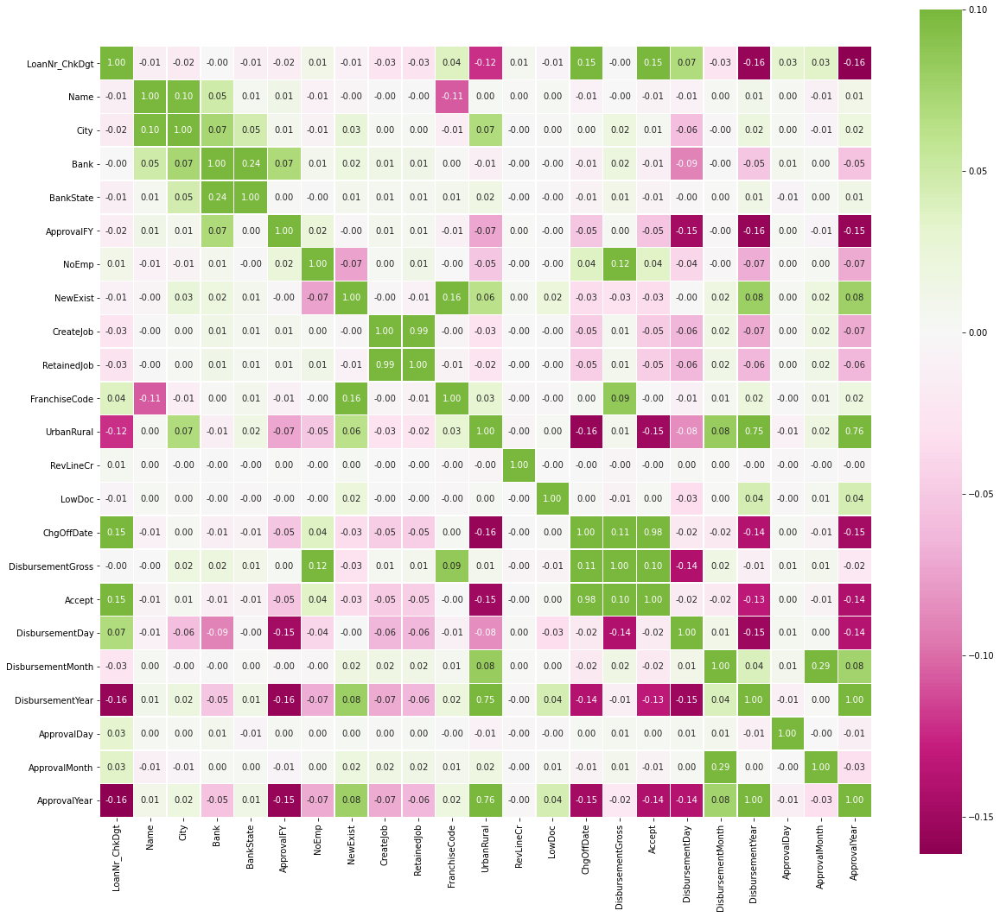

In [149]:
train = df

def corr_heatmap(train):
    correlations = train.corr()

    fig, ax = plt.subplots(figsize=(20,20))
    sns.heatmap(correlations, vmax=0.1, center=0, fmt='.2f',cmap="PiYG",
                square=True, linewidths=.5, annot=True, cbar_kws={"shrink": 0.9})
    plt.show();
    
corr_heatmap(train)

## Creación de ExpFeat

In [150]:
df['ExpFeat'] = df['ChgOffDate']

In [151]:
for i in df.index:
    if (df['ChgOffDate'][i] == 1 and df['FranchiseCode'][i] == 51630 and df['DisbursementGross'][i] < 5000):
        df['ExpFeat'][i] = 0
        #print(df['ExpFeat'][i])

In [152]:
df_test_nolabel['ExpFeat'] = df_test_nolabel['ChgOffDate']

In [153]:
for i in df_test_nolabel.index:
    if (df_test_nolabel['ChgOffDate'][i] == 1 and df_test_nolabel['FranchiseCode'][i] == 51630 and df_test_nolabel['DisbursementGross'][i] < 5000):
        df_test_nolabel['ExpFeat'][i] = 0
        #print(df_test_nolabel['ExpFeat'][i])

## Machine Learning

### KNN: Training

In [217]:
#Train Test Split
#Use train_test_split to split your data into a training set and a testing set
from sklearn.model_selection import train_test_split
features = ['ExpFeat', 'UrbanRural', 'ApprovalYear']
X=df[features]
y=df['Accept']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

In [155]:
#Using KNN
#Import KNeighborsClassifier from scikit learn.
from sklearn.neighbors import KNeighborsClassifier

In [156]:
#Create a KNN model instance with n_neighbors=
knn = KNeighborsClassifier(n_neighbors = 4)

In [157]:
#Fit this KNN model to the training data.
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=4)

In [158]:
#Predictions and Evaluations
#Let's evaluate our KNN model!
#Use the predict method to predict values using your KNN model and X_test.

pred = knn.predict(X_test)

In [159]:
#Create a confusion matrix and classification report.
from sklearn.metrics import classification_report, confusion_matrix

In [160]:
#Calculate the confusion matrix, which will help us to know the data that has 
#been correctly predicted (main diagonal = 6730), and the wrong data (secondary diagonal = 1916)
print(confusion_matrix(y_test, pred))

[[1898    4]
 [  38 7770]]


In [161]:
#Calculate model precision
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1902
           1       1.00      1.00      1.00      7808

    accuracy                           1.00      9710
   macro avg       0.99      1.00      0.99      9710
weighted avg       1.00      1.00      1.00      9710



In [162]:
#We use this code to find a best K number to our algorithm
from sklearn.model_selection import GridSearchCV
param_grid = {'n_neighbors': np.arange(1, 10,1)} 
gs = GridSearchCV(KNeighborsClassifier(), param_grid)
gs.fit(X_train, y_train)
print("Best score: ", gs.best_score_)
print("Best params: ", gs.best_params_)
for i, max_depth in enumerate(gs.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (gs.cv_results_['mean_test_score'][i],
                                        gs.cv_results_['std_test_score'][i] * 2,
                                        max_depth))

Best score:  0.9933568165879649
Best params:  {'n_neighbors': 2}
0.986 (+/-0.016) for {'n_neighbors': 1}
0.993 (+/-0.002) for {'n_neighbors': 2}
0.993 (+/-0.002) for {'n_neighbors': 3}
0.993 (+/-0.002) for {'n_neighbors': 4}
0.993 (+/-0.002) for {'n_neighbors': 5}
0.993 (+/-0.002) for {'n_neighbors': 6}
0.993 (+/-0.002) for {'n_neighbors': 7}
0.993 (+/-0.002) for {'n_neighbors': 8}
0.993 (+/-0.002) for {'n_neighbors': 9}


In [163]:
#kNN para 9 vecinos
knn = KNeighborsClassifier(n_neighbors =4)
knn.fit(X_train, y_train)
pred = knn.predict(X_test)
print(confusion_matrix(y_test, pred))
print(classification_report(y_test, pred))

[[1898    4]
 [  38 7770]]
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1902
           1       1.00      1.00      1.00      7808

    accuracy                           1.00      9710
   macro avg       0.99      1.00      0.99      9710
weighted avg       1.00      1.00      1.00      9710



### KNN: Results

In [164]:
ids_test = df_test_nolabel['id']

features = ['ExpFeat', 'UrbanRural', 'ApprovalYear']
X=df_test_nolabel[features]
y_pred=knn.predict(X)

In [165]:
results = df_test_nolabel[["id"]]
results["AcceptFloat"] = y_pred
results["Accept"] = results["AcceptFloat"].values.astype(int)
results.drop(['AcceptFloat'], axis=1, inplace=True)
results["id"].size

7994

In [166]:
results.to_csv("resultsKNN_good.csv", index_label=False, index=False)

### Decision Tree: Training

In [218]:
# Training and test spliting
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

# Si se incluyen features con nan no funciona el árbol
features = ['ExpFeat', 'UrbanRural', 'ApprovalYear']

# Transform dataframe in numpy arrays
X = df[features].values
y = df['Accept'].values

# Test set will be the 25% taken randomly
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05, random_state=33)

# Preprocess: normalize
scaler = preprocessing.StandardScaler().fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [219]:
from sklearn.model_selection import GridSearchCV
param_grid = {'max_depth': np.arange(1, 20)} 

gs = GridSearchCV(DecisionTreeClassifier(), param_grid)

gs.fit(X_train, y_train)

# summarize the results of the grid search
print("Best score: ", gs.best_score_)
print("Best params: ", gs.best_params_)

Best score:  0.9934340664914025
Best params:  {'max_depth': 1}


In [220]:
# We print the score for each value of max_depth
for i, max_depth in enumerate(gs.cv_results_['params']):
    print("%0.4f (+/-%0.04f) for %r" % (gs.cv_results_['mean_test_score'][i],
                                        gs.cv_results_['std_test_score'][i] * 2,
                                        max_depth))

0.9934 (+/-0.0015) for {'max_depth': 1}
0.9934 (+/-0.0015) for {'max_depth': 2}
0.9934 (+/-0.0015) for {'max_depth': 3}
0.9934 (+/-0.0015) for {'max_depth': 4}
0.9934 (+/-0.0015) for {'max_depth': 5}
0.9934 (+/-0.0015) for {'max_depth': 6}
0.9934 (+/-0.0015) for {'max_depth': 7}
0.9934 (+/-0.0015) for {'max_depth': 8}
0.9934 (+/-0.0015) for {'max_depth': 9}
0.9934 (+/-0.0015) for {'max_depth': 10}
0.9934 (+/-0.0015) for {'max_depth': 11}
0.9934 (+/-0.0015) for {'max_depth': 12}
0.9934 (+/-0.0015) for {'max_depth': 13}
0.9934 (+/-0.0015) for {'max_depth': 14}
0.9934 (+/-0.0015) for {'max_depth': 15}
0.9934 (+/-0.0015) for {'max_depth': 16}
0.9934 (+/-0.0015) for {'max_depth': 17}
0.9934 (+/-0.0015) for {'max_depth': 18}
0.9934 (+/-0.0015) for {'max_depth': 19}


In [221]:
# Evaluation
from sklearn import metrics
from sklearn.model_selection import cross_val_score, KFold, StratifiedKFold
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

model = tree.DecisionTreeClassifier(criterion='gini',
                                            splitter="best",
                                            min_samples_split=3,
                                            min_samples_leaf=3,
                                            max_depth = 3,
                                            class_weight= {0:0.96,1:0.96} )

model.fit(X_train, y_train)
predicted = model.predict(X_test)
expected = y_test

# Accuracy
metrics.accuracy_score(expected, predicted)

0.9956745623069001

In [222]:
cv = KFold(n_splits=20, shuffle=False)
scores = cross_val_score(model, X, y, cv=cv)

print("Scores in every iteration", scores)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Scores in every iteration [0.99258649 0.9946458  0.99341021 0.99505766 0.9946458  0.99423394
 0.99546952 0.99052328 0.99587969 0.99423156 0.99381953 0.99299547
 0.99217141 0.98969922 0.99629172 0.99629172 0.99546766 0.99546766
 0.99299547 0.99175937]
Accuracy: 0.99 (+/- 0.00)


In [223]:
y_train_pred = model.predict(X_train)
print("Accuracy in training", metrics.accuracy_score(y_train, y_train_pred))

Accuracy in training 0.9934340963514174


In [224]:
print(classification_report(y_train, y_train_pred))

              precision    recall  f1-score   support

           0       0.97      1.00      0.98      7299
           1       1.00      0.99      1.00     31538

    accuracy                           0.99     38837
   macro avg       0.98      1.00      0.99     38837
weighted avg       0.99      0.99      0.99     38837



In [174]:
ids_test = df_test_nolabel['id']

features = ['ExpFeat', 'UrbanRural', 'ApprovalYear']
X=df_test_nolabel[features]
y_pred=model.predict(X)

In [175]:
results = df_test_nolabel[["id"]]
results["AcceptFloat"] = y_pred
results["Accept"] = results["AcceptFloat"].values.astype(int)
results.drop(['AcceptFloat'], axis=1, inplace=True)
results["id"].size

7994

In [176]:
results.to_csv("resultsDT_good.csv", index_label=False, index=False)

In [177]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score,f1_score


tree_clf = DecisionTreeClassifier()
tree_clf.fit(X_train,y_train)
y_pred = tree_clf.predict(X_train)

print("Training Data Set Accuracy: ", accuracy_score(y_train,y_pred))
print("Training Data F1 Score ", f1_score(y_train,y_pred))

print("Validation Mean F1 Score: ",cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='f1_macro').mean())
print("Validation Mean Accuracy: ",cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='accuracy').mean())

Training Data Set Accuracy:  0.9938420173897959
Training Data F1 Score  0.9961905783882391
Validation Mean F1 Score:  0.9900664754807765
Validation Mean Accuracy:  0.9938420122061828


In [178]:
df.head()

,LoanNr_ChkDgt,Name,City,Bank,BankState,ApprovalFY,NoEmp,NewExist,CreateJob,RetainedJob,...,ChgOffDate,DisbursementGross,Accept,DisbursementDay,DisbursementMonth,DisbursementYear,ApprovalDay,ApprovalMonth,ApprovalYear,ExpFeat
0,6340864010,0.0,0.0,0.0,0.0,0.0,10,1.0,2,10,...,1,150000.0,1,30.0,6.0,2003.0,22,5,2003,1
1,1670916004,1.0,1.0,0.0,1.0,1.0,1,1.0,0,1,...,1,250000.0,1,31.0,7.0,2006.0,7,4,2006,1
2,7568313003,2.0,2.0,2.0,2.0,2.0,5,2.0,0,0,...,1,53000.0,1,31.0,10.0,1994.0,12,9,1994,1
3,4585814005,3.0,3.0,3.0,3.0,3.0,1,2.0,3,1,...,1,170000.0,1,31.0,8.0,2001.0,18,6,2001,1
4,2003866003,4.0,0.0,4.0,2.0,1.0,5,1.0,0,5,...,1,121000.0,1,31.0,5.0,2006.0,12,5,2006,1


OverFitting Problem : We can see from above metrics that Training Accuracy > Test Accuracy with default settings of Decision Tree classifier. Hence, model is overfit. We will try some Hyper-parameter tuning and see if it helps.

First let's try tuning 'Max_Depth' of tree

<AxesSubplot:xlabel='Max_Depth', ylabel='Values'>

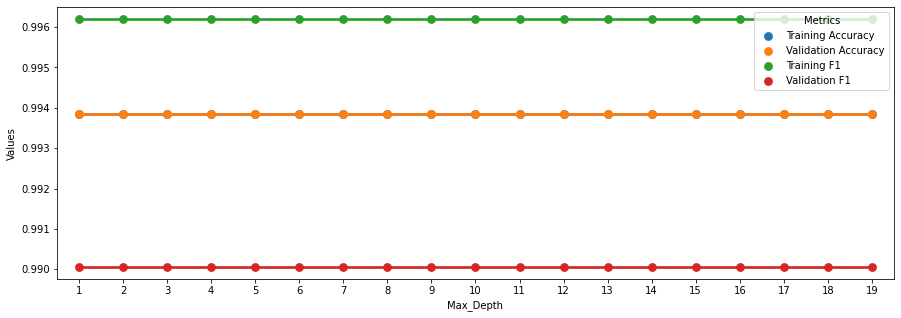

In [179]:
training_accuracy = []
val_accuracy = []
training_f1 = []
val_f1 = []
tree_depths = []

for depth in range(1,20):
    tree_clf = DecisionTreeClassifier(max_depth=depth)
    tree_clf.fit(X_train,y_train)
    y_training_pred = tree_clf.predict(X_train)

    training_acc = accuracy_score(y_train,y_training_pred)
    train_f1 = f1_score(y_train,y_training_pred)
    val_mean_f1 = cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='f1_macro').mean()
    val_mean_accuracy = cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='accuracy').mean()
    
    training_accuracy.append(training_acc)
    val_accuracy.append(val_mean_accuracy)
    training_f1.append(train_f1)
    val_f1.append(val_mean_f1)
    tree_depths.append(depth)
    

Tuning_Max_depth = {"Training Accuracy": training_accuracy, "Validation Accuracy": val_accuracy, "Training F1": training_f1, "Validation F1":val_f1, "Max_Depth": tree_depths }
Tuning_Max_depth_df = pd.DataFrame.from_dict(Tuning_Max_depth)

plot_df = Tuning_Max_depth_df.melt('Max_Depth',var_name='Metrics',value_name="Values")

fig,ax = plt.subplots(figsize=(15,5))
sns.pointplot(x="Max_Depth", y="Values",hue="Metrics", data=plot_df,ax=ax)

From above graph, we can conclude that keeping 'Max_Depth' = 3 will yield optimum Test accuracy and F1 score Optimum.

**Visulazing Decision Tree with Max Depth = 3**

In [180]:
from sklearn import tree
tree_clf = tree.DecisionTreeClassifier(max_depth = 3)
tree_clf.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=3)

[Text(558.0, 475.65000000000003, 'X[0] <= -0.772\ngini = 0.307\nsamples = 46119\nvalue = [8717, 37402]'),
 Text(279.0, 339.75, 'X[2] <= 0.346\ngini = 0.058\nsamples = 8969\nvalue = [8701, 268]'),
 Text(139.5, 203.85000000000002, 'X[2] <= -3.873\ngini = 0.032\nsamples = 3016\nvalue = [2967, 49]'),
 Text(69.75, 67.94999999999999, 'gini = 0.18\nsamples = 20\nvalue = [18, 2]'),
 Text(209.25, 67.94999999999999, 'gini = 0.031\nsamples = 2996\nvalue = [2949, 47]'),
 Text(418.5, 203.85000000000002, 'X[1] <= -0.273\ngini = 0.071\nsamples = 5953\nvalue = [5734, 219]'),
 Text(348.75, 67.94999999999999, 'gini = 0.159\nsamples = 195\nvalue = [178, 17]'),
 Text(488.25, 67.94999999999999, 'gini = 0.068\nsamples = 5758\nvalue = [5556, 202]'),
 Text(837.0, 339.75, 'X[2] <= 0.177\ngini = 0.001\nsamples = 37150\nvalue = [16, 37134]'),
 Text(697.5, 203.85000000000002, 'X[2] <= -0.835\ngini = 0.001\nsamples = 20392\nvalue = [6, 20386]'),
 Text(627.75, 67.94999999999999, 'gini = 0.001\nsamples = 9723\nvalue

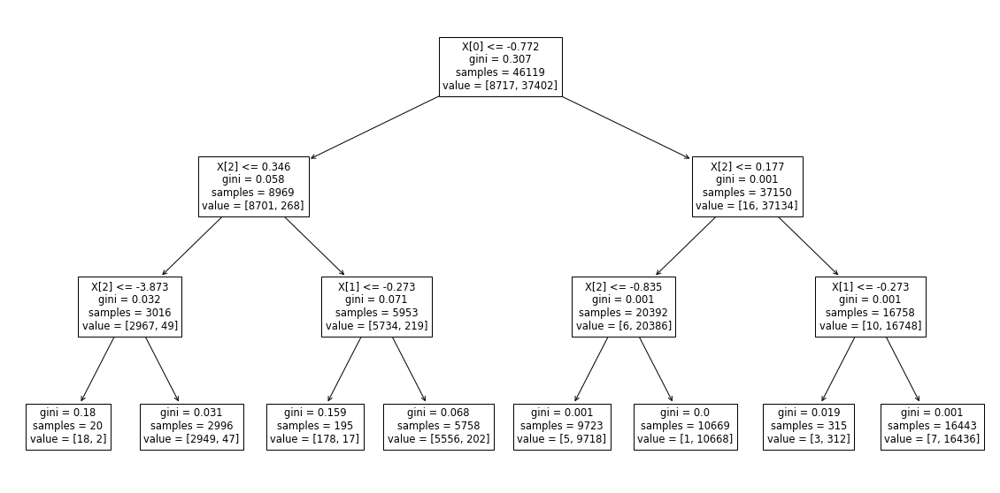

In [181]:
plt.figure(figsize=(20,10))
tree.plot_tree(tree_clf)

From above tree, we could see that some of the leafs have less than 20 samples hence our classifier might overfit. We can sweep hyper-parameter 'min_samples_leaf' to further improve test accuracy by keeping max_depth to 3

<AxesSubplot:xlabel='Min_Samples_leaf', ylabel='Values'>

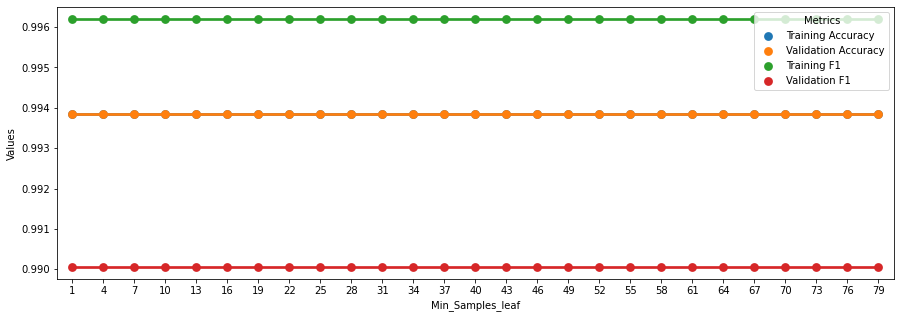

In [182]:
training_accuracy = []
val_accuracy = []
training_f1 = []
val_f1 = []
min_samples_leaf = []
import numpy as np
for samples_leaf in range(1,80,3): ### Sweeping from 1% samples to 10% samples per leaf 
    tree_clf = DecisionTreeClassifier(max_depth=3,min_samples_leaf = samples_leaf)
    tree_clf.fit(X_train,y_train)
    y_training_pred = tree_clf.predict(X_train)

    training_acc = accuracy_score(y_train,y_training_pred)
    train_f1 = f1_score(y_train,y_training_pred)
    val_mean_f1 = cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='f1_macro').mean()
    val_mean_accuracy = cross_val_score(tree_clf,X_train,y_train,cv=5,scoring='accuracy').mean()
    
    training_accuracy.append(training_acc)
    val_accuracy.append(val_mean_accuracy)
    training_f1.append(train_f1)
    val_f1.append(val_mean_f1)
    min_samples_leaf.append(samples_leaf)
    

Tuning_min_samples_leaf = {"Training Accuracy": training_accuracy, "Validation Accuracy": val_accuracy, "Training F1": training_f1, "Validation F1":val_f1, "Min_Samples_leaf": min_samples_leaf }
Tuning_min_samples_leaf_df = pd.DataFrame.from_dict(Tuning_min_samples_leaf)

plot_df = Tuning_min_samples_leaf_df.melt('Min_Samples_leaf',var_name='Metrics',value_name="Values")
fig,ax = plt.subplots(figsize=(15,5))
sns.pointplot(x="Min_Samples_leaf", y="Values",hue="Metrics", data=plot_df,ax=ax)

From above plot, we will choose Min_Samples_leaf to 35 to improve test accuracy.

In [183]:
from sklearn.metrics import confusion_matrix
tree_clf = DecisionTreeClassifier(max_depth=3,min_samples_leaf = 35)
tree_clf.fit(X_train,y_train)
y_pred = tree_clf.predict(X_test)
print("Test Accuracy: ",accuracy_score(y_test,y_pred))
print("Test F1 Score: ",f1_score(y_test,y_pred))
print("Confusion Matrix on Test Data")
pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True)

Test Accuracy:  0.9946457990115322
Test F1 Score:  0.9966503478484927
Confusion Matrix on Test Data


Predicted,0,1,All
True,,,
0,481,3,484
1,10,1934,1944
All,491,1937,2428


### GaussianNB: Training

In [184]:
#Train Test Split
#Use train_test_split to split your data into a training set and a testing set
from sklearn.model_selection import train_test_split
features= ['ChgOffDate', 'UrbanRural', 'ApprovalYear']
X=df[features]
y=df['Accept']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

In [185]:
#Import Gaussian Naive Bayes model
from sklearn.naive_bayes import GaussianNB

#Create a Gaussian Classifier
model = GaussianNB()

# Train the model using the training sets
model.fit(X_train, y_train)

#Predict Output
predicted= model.predict(X_test) # 0:Overcast, 2:Mild
print ("Predicted Value:", predicted)

Predicted Value: [1 0 1 ... 1 0 1]


In [186]:
#Calculate model precision
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1902
           1       1.00      1.00      1.00      7808

    accuracy                           1.00      9710
   macro avg       0.99      1.00      0.99      9710
weighted avg       1.00      1.00      1.00      9710



### GaussianNB: Result

In [187]:
ids_test = df_test_nolabel['id']

features = ['ChgOffDate', 'UrbanRural', 'ApprovalYear']
X=df_test_nolabel[features]
y_pred=model.predict(X)

In [188]:
results = df_test_nolabel[["id"]]
results["AcceptFloat"] = y_pred
results["Accept"] = results["AcceptFloat"].values.astype(int)
results.drop(['AcceptFloat'], axis=1, inplace=True)
results["id"].size

7994

In [189]:
results.to_csv("resultsGaussianNB_good.csv", index_label=False, index=False)

### Random Forest



In [272]:
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier()

In [273]:
df.shape

(48547, 24)

In [274]:
model.fit(X_train,y_train)

RandomForestClassifier()

In [275]:
model.score(X_test, y_test)

0.9956745623069001

In [276]:
from sklearn.model_selection import learning_curve

In [257]:
#fi = pd.DataFrame({'feature': X_train.columns, 'importance': model.feature_importances_}).sort_values(by='importance', ascending=False)
#fi = fi.reset_index()
#fi

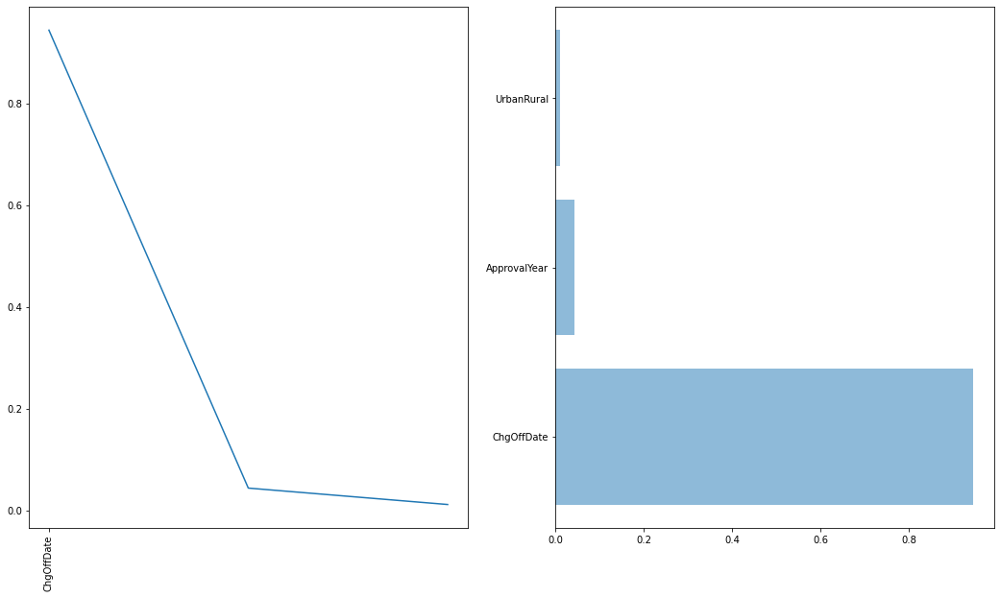

In [277]:
def plot_feature_importance(fi):
    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(18,10))
    ax1.plot(np.arange(0, len(fi.index)), fi['importance'])
    label_nrs = np.arange(0, len(fi.index), 5 )
    ax1.set_xticks(label_nrs)
    ax1.set_xticklabels(fi['feature'][label_nrs], rotation=90)
    
    num_bar = min(len(fi.index), 30)
    ax2.barh(np.arange(0, num_bar), fi['importance'][:num_bar], align='center', alpha=0.5)
    ax2.set_yticks(np.arange(0, num_bar))
    ax2.set_yticklabels(fi['feature'][:num_bar])

plot_feature_importance(fi)

In [278]:
from sklearn.model_selection import learning_curve
from sklearn.model_selection import cross_val_score, KFold, StratifiedKFold
from sklearn.metrics import classification_report

In [279]:
# Cross-validationt
cv = KFold(n_splits=5, shuffle=False, random_state=None)
# StratifiedKFold has is a variation of k-fold which returns stratified folds:
# each set contains approximately the same percentage of samples of each target class as the complete set.
#cv = StratifiedKFold(y, n_folds=3, shuffle=False, random_state=33)
scores = cross_val_score(model, X, y, cv=cv)
print("Scores in every iteration", scores)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

ValueError: Found input variables with inconsistent numbers of samples: [7994, 48547]

In [280]:
def plot_learning_curve(estimator, title, X, y, axes=None, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    """
    Generate 3 plots: the test and training learning curve, the training
    samples vs fit times curve, the fit times vs score curve.

    Parameters
    ----------
    estimator : estimator instance
        An estimator instance implementing `fit` and `predict` methods which
        will be cloned for each validation.

    title : str
        Title for the chart.

    X : array-like of shape (n_samples, n_features)
        Training vector, where ``n_samples`` is the number of samples and
        ``n_features`` is the number of features.

    y : array-like of shape (n_samples) or (n_samples, n_features)
        Target relative to ``X`` for classification or regression;
        None for unsupervised learning.

    axes : array-like of shape (3,), default=None
        Axes to use for plotting the curves.

    ylim : tuple of shape (2,), default=None
        Defines minimum and maximum y-values plotted, e.g. (ymin, ymax).

    cv : int, cross-validation generator or an iterable, default=None
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:

          - None, to use the default 5-fold cross-validation,
          - integer, to specify the number of folds.
          - :term:`CV splitter`,
          - An iterable yielding (train, test) splits as arrays of indices.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : int or None, default=None
        Number of jobs to run in parallel.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.

    train_sizes : array-like of shape (n_ticks,)
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve. If the ``dtype`` is float, it is regarded
        as a fraction of the maximum size of the training set (that is
        determined by the selected validation method), i.e. it has to be within
        (0, 1]. Otherwise it is interpreted as absolute sizes of the training
        sets. Note that for classification the number of samples usually have
        to be big enough to contain at least one sample from each class.
        (default: np.linspace(0.1, 1.0, 5))
    """
    if axes is None:
        _, axes = plt.subplots(1, 3, figsize=(20, 5))

    axes[0].set_title(title)
    if ylim is not None:
        axes[0].set_ylim(*ylim)
    axes[0].set_xlabel("Training examples")
    axes[0].set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = \
        learning_curve(estimator, X, y, cv=cv, n_jobs=n_jobs,
                       train_sizes=train_sizes,
                       return_times=True)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)

    # Plot learning curve
    axes[0].grid()
    axes[0].fill_between(train_sizes, train_scores_mean - train_scores_std,
                         train_scores_mean + train_scores_std, alpha=0.1,
                         color="r")
    axes[0].fill_between(train_sizes, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1,
                         color="g")
    axes[0].plot(train_sizes, train_scores_mean, 'o-', color="r",
                 label="Training score")
    axes[0].plot(train_sizes, test_scores_mean, 'o-', color="g",
                 label="Cross-validation score")
    axes[0].legend(loc="best")

    # Plot n_samples vs fit_times
    axes[1].grid()
    axes[1].plot(train_sizes, fit_times_mean, 'o-')
    axes[1].fill_between(train_sizes, fit_times_mean - fit_times_std,
                         fit_times_mean + fit_times_std, alpha=0.1)
    axes[1].set_xlabel("Training examples")
    axes[1].set_ylabel("fit_times")
    axes[1].set_title("Scalability of the model")

    # Plot fit_time vs score
    axes[2].grid()
    axes[2].plot(fit_times_mean, test_scores_mean, 'o-')
    axes[2].fill_between(fit_times_mean, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1)
    axes[2].set_xlabel("fit_times")
    axes[2].set_ylabel("Score")
    axes[2].set_title("Performance of the model")

    return plt

ValueError: Found input variables with inconsistent numbers of samples: [7994, 48547]

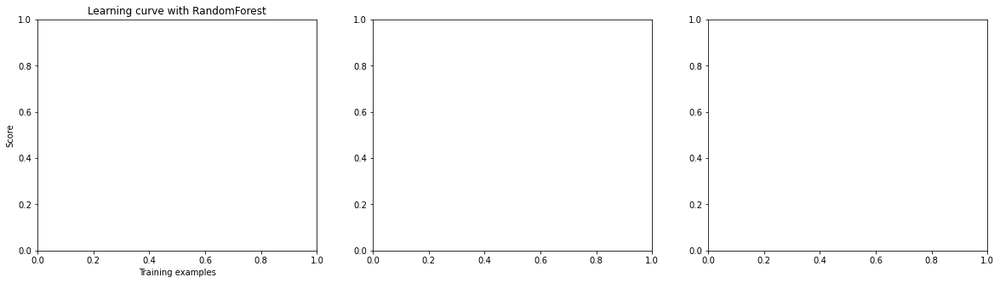

In [281]:
from sklearn.model_selection import learning_curve

plot_learning_curve(model, "Learning curve with RandomForest", X, y, cv=cv)

In [ ]:
rf_clf = RandomForestClassifier(n_estimators=100,max_depth=3,min_samples_leaf = 10)
rf_clf.fit(X_train,y_train)
y_pred = rf_clf.predict(X_train)
print(rf_clf.score(X_test, y_test))
print("Train F1 Score ", f1_score(y_train,y_pred))
print("Train Accuracy ", accuracy_score(y_train,y_pred))

print("Validation Mean F1 Score: ",cross_val_score(rf_clf,X_train,y_train,cv=5,scoring='f1_macro').mean())
print("Validation Mean Accuracy: ",cross_val_score(rf_clf,X_train,y_train,cv=5,scoring='accuracy').mean())

In [265]:
y_pred = rf_clf.predict(X_test)
print("Test Accuracy: ",accuracy_score(y_test,y_pred))
print("Test F1 Score: ",f1_score(y_test,y_pred))
print("Confusion Matrix on Test Data")
pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True)

Test Accuracy:  0.9956745623069001
Test F1 Score:  0.9973045822102425
Confusion Matrix on Test Data


Predicted,0,1,All
True,,,
0,1898,4,1902
1,38,7770,7808
All,1936,7774,9710


In [269]:
(df_test_nolabel.isna().sum()/df.shape[0]).sort_values(ascending=True)

id                   0.000000
ApprovalMonth        0.000000
ApprovalDay          0.000000
BalanceGross         0.000000
DisbursementGross    0.000000
ChgOffDate           0.000000
LowDoc               0.000000
RevLineCr            0.000000
UrbanRural           0.000000
ApprovalYear         0.000000
RetainedJob          0.000000
FranchiseCode        0.000000
NewExist             0.000000
NoEmp                0.000000
ApprovalFY           0.000000
BankState            0.000000
Bank                 0.000000
State                0.000000
City                 0.000000
Name                 0.000000
LoanNr_ChkDgt        0.000000
CreateJob            0.000000
ExpFeat              0.000000
DisbursementDay      0.000288
DisbursementMonth    0.000288
DisbursementYear     0.000288
dtype: float64

In [270]:
ids_test = df_test_nolabel['id']

features= ['LoanNr_ChkDgt', 'City', 'Bank', 'ApprovalFY', 'NoEmp',
       'NewExist', 'CreateJob', 'RetainedJob', 'FranchiseCode', 'UrbanRural',
       'ChgOffDate', 'DisbursementGross',
       'ApprovalDay', 'ApprovalMonth', 'ApprovalYear']

X=df_test_nolabel[features]
y_pred=rf_clf.predict(X)

ValueError: X has 15 features, but DecisionTreeClassifier is expecting 3 features as input.

In [271]:
results = df_test_nolabel[["id"]]
results["AcceptFloat"] = y
results["Accept"] = results["AcceptFloat"].values.astype(int)
results.drop(['AcceptFloat'], axis=1, inplace=True)
results["id"].size

ValueError: Length of values (48547) does not match length of index (7994)

In [250]:
results.to_csv("resultsRandomForest.csv", index_label=False, index=False)

# 4. Result of the competition
### A. Introducción
### B. Modelo Geométrico: KNN
### C. Modelo Decision Tree
### D. Modelo Gaussian NB
-----------------------------------------
### A. Introducción
Una vez disponga de un modelo, deberá usar la plataforma Kaggle para probar su modelo con datos, que combinan datos nuevos con los datos existentes. Puede realizar tantos intentos como desee. 
Razone los resultados en el cuaderno.
### B. Modelo Geométrico: KNN
Knn para 9 vecinos con todas las features preprocesadas
 
      precision    recall  f1-score   support

           0       0.28      0.28      0.28      2817
           1       0.83      0.83      0.83     11748

    accuracy                           0.72     14565
   macro avg       0.55      0.55      0.55     14565
weighted avg       0.72      0.72      0.72     14565

Best score:  0.7972748684351014
Best params:  {'n_neighbors': 9}

  Knn para 9 vecinos con 4 features preprocesadas
  
       precision    recall  f1-score   support

           0       0.36      0.08      0.14      2817
           1       0.81      0.96      0.88     11748

    accuracy                           0.79     14565
   macro avg       0.59      0.52      0.51     14565
weighted avg       0.73      0.79      0.74     14565

Best score:  0.7972748684351014
Best params:  {'n_neighbors': 9}

Knn con 4 features: 0.62095


Con 4 vecinos

                 precision    recall  f1-score   support

           0       0.98      1.00      0.99      1902
           1       1.00      1.00      1.00      7808

    accuracy                           1.00      9710
   macro avg       0.99      1.00      0.99      9710
weighted avg       1.00      1.00      1.00      9710

Con 9 vecinos

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1902
           1       1.00      1.00      1.00      7808

    accuracy                           1.00      9710
   macro avg       0.99      1.00      0.99      9710
weighted avg       1.00      1.00      1.00      9710


### C. Modelo Decision Tree

Decison tree con todas las variables (bueno, las que no tienen nan) preprocesadas 

              precision    recall  f1-score   support

           0       0.71      0.22      0.34      6892
           1       0.84      0.98      0.91     29518

    accuracy                           0.84     36410
   macro avg       0.78      0.60      0.62     36410
weighted avg       0.82      0.84      0.80     36410

Accuracy in training 0.8353474320241692

Best score:  0.8292776709695138
Best params:  {'max_depth': 6}

0.66588 en kaagle 

Decison tree con 4 variables preprocesadas

              precision    recall  f1-score   support

           0       0.71      0.20      0.31      6892
           1       0.84      0.98      0.90     29518

    accuracy                           0.83     36410
   macro avg       0.77      0.59      0.61     36410
weighted avg       0.81      0.83      0.79     36410

0.8155251893315772


Tienen mejor valor en el 0 que el knn

                precision    recall  f1-score   support

           0       0.97      1.00      0.98      8717
           1       1.00      0.99      1.00     37402

    accuracy                           0.99     46119
   macro avg       0.98      0.99      0.99     46119
weighted avg       0.99      0.99      0.99     46119

### D. Modelo Gaussian NB


              precision    recall  f1-score   support

           0       0.36      0.08      0.14      2817
           1       0.81      0.96      0.88     11748

    accuracy                           0.79     14565
   macro avg       0.59      0.52      0.51     14565
weighted avg       0.73      0.79      0.74     14565


Reusltado de kaagle 0.9932

# References

Notebooks de la asignatura